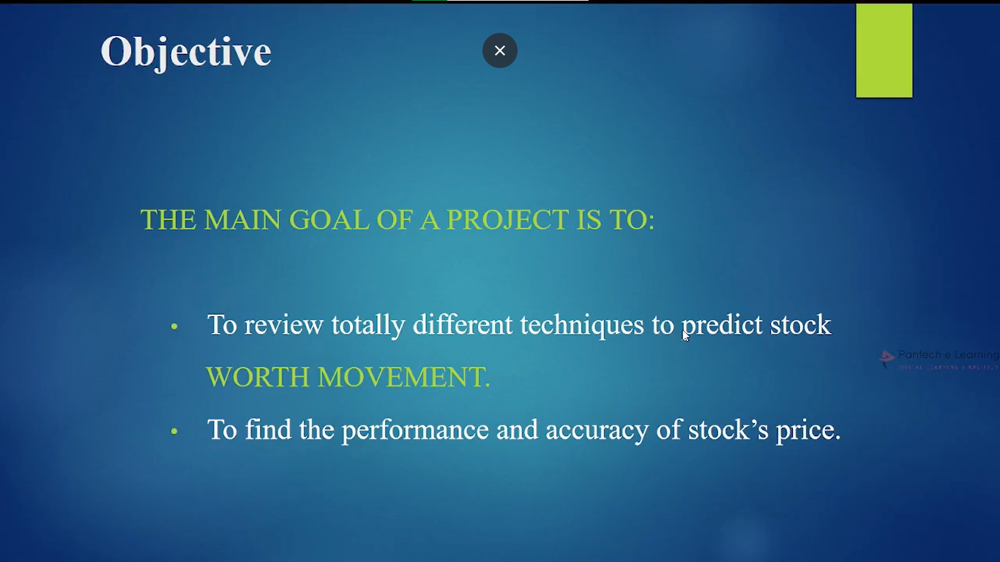

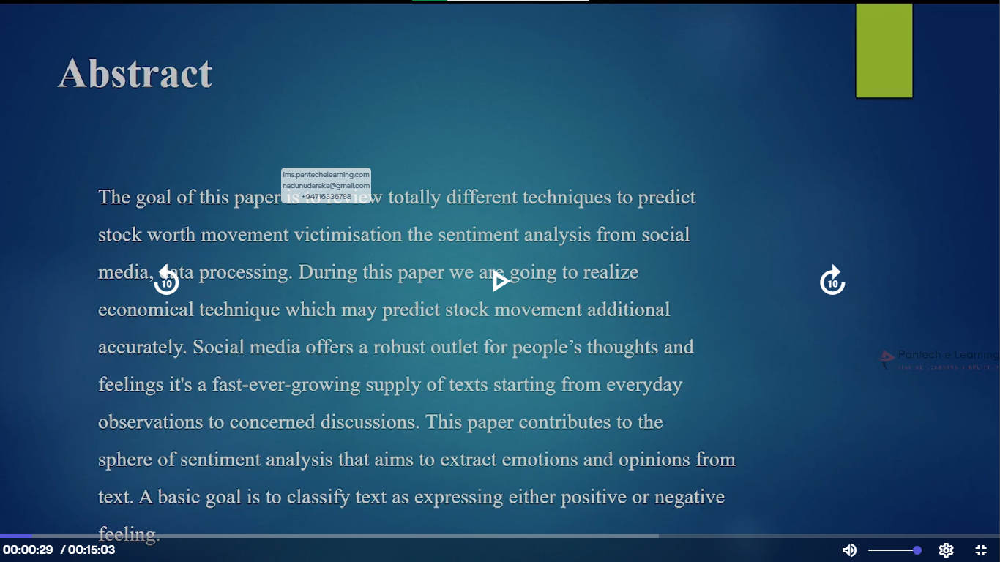

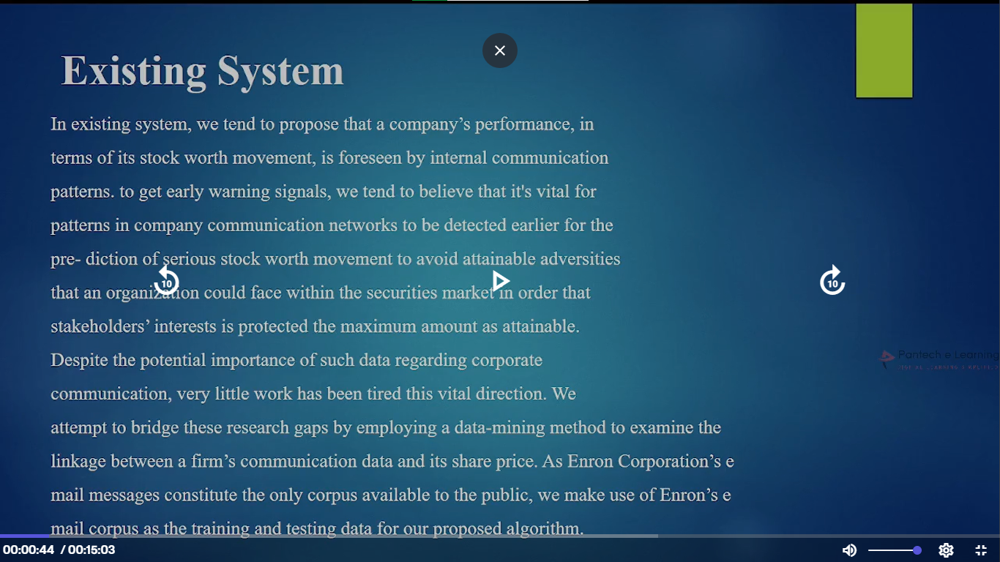

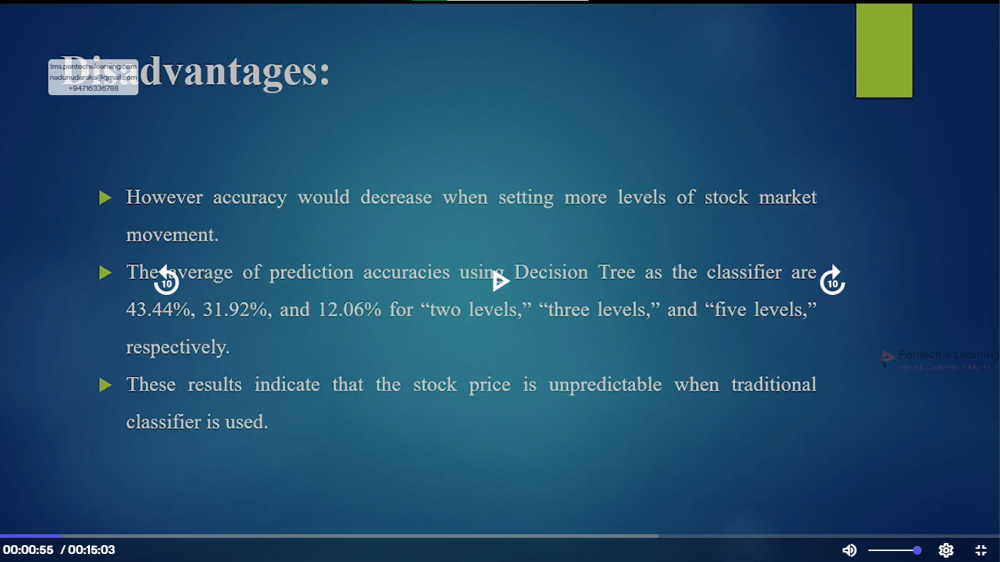

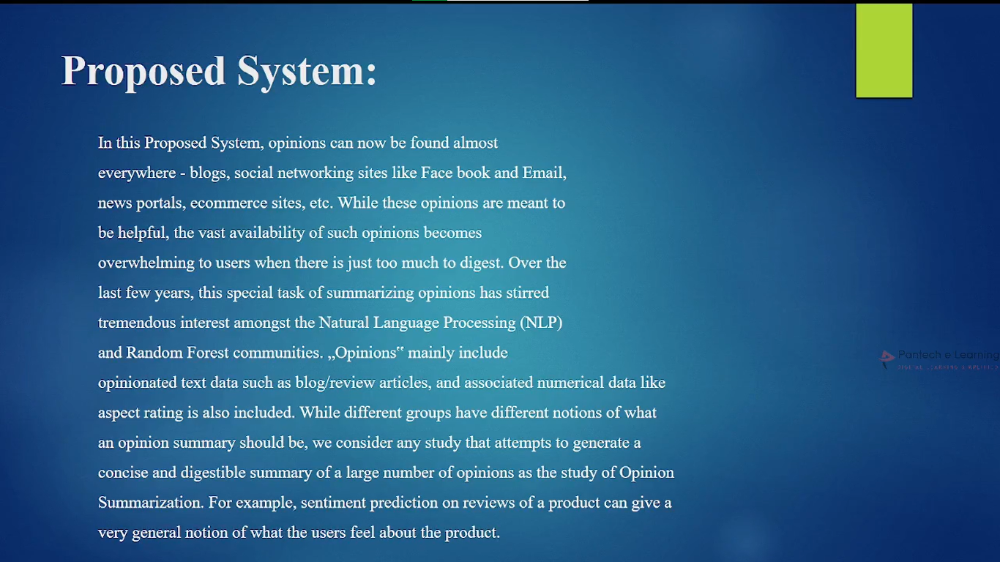

...

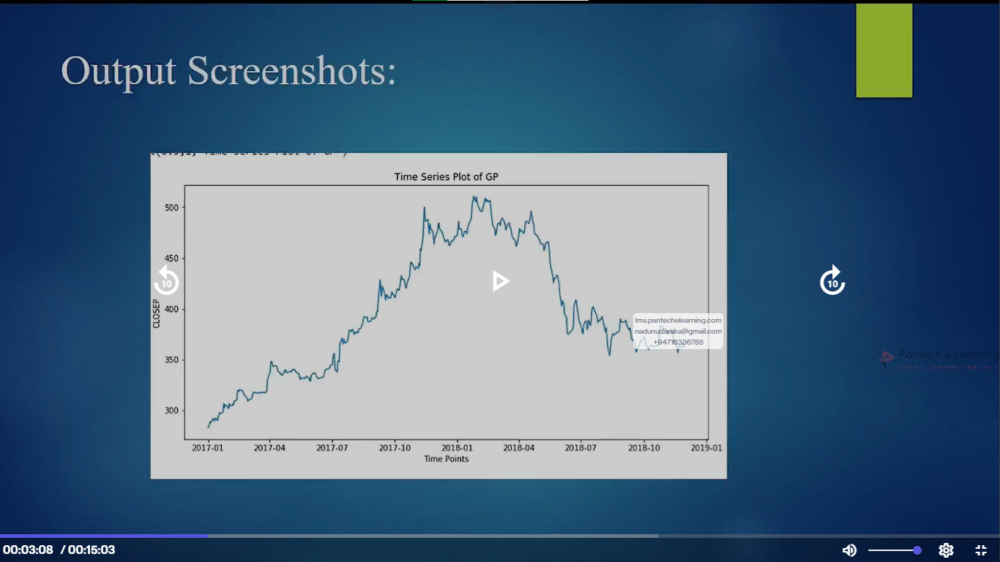

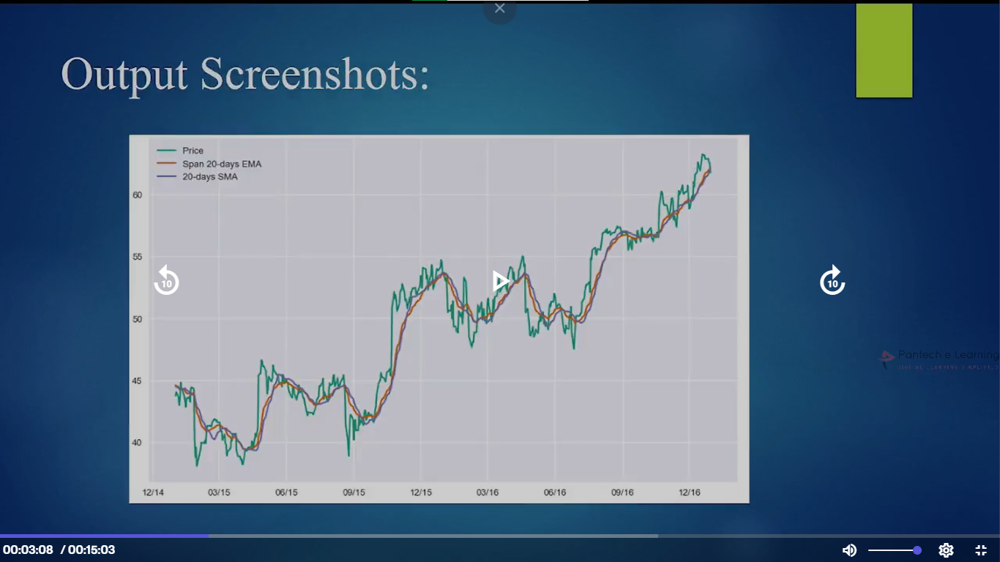

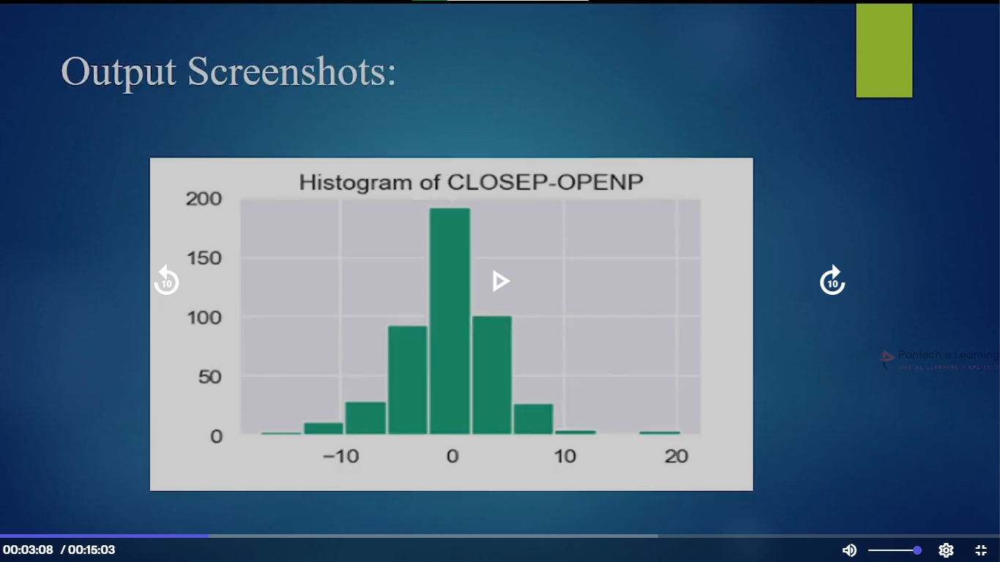

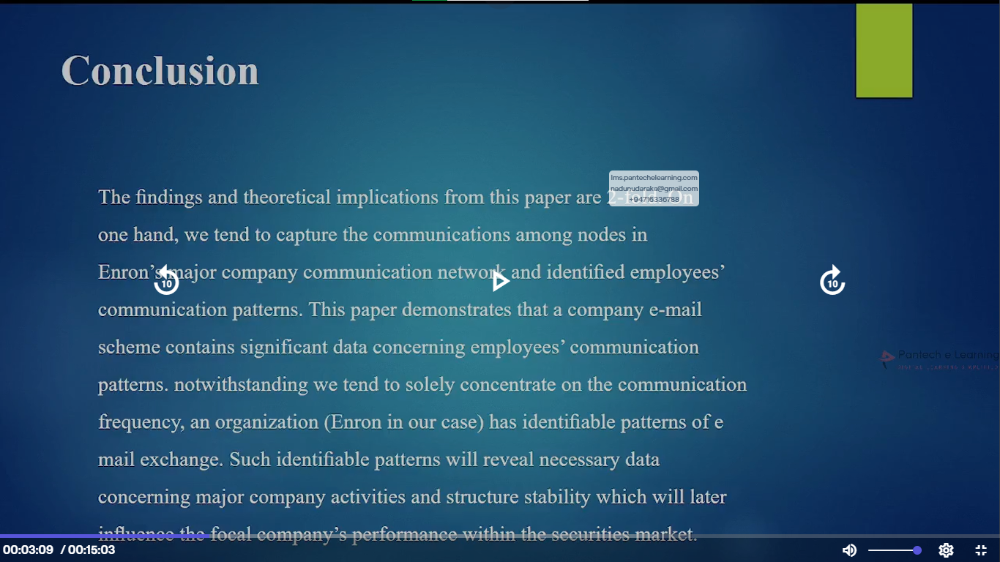

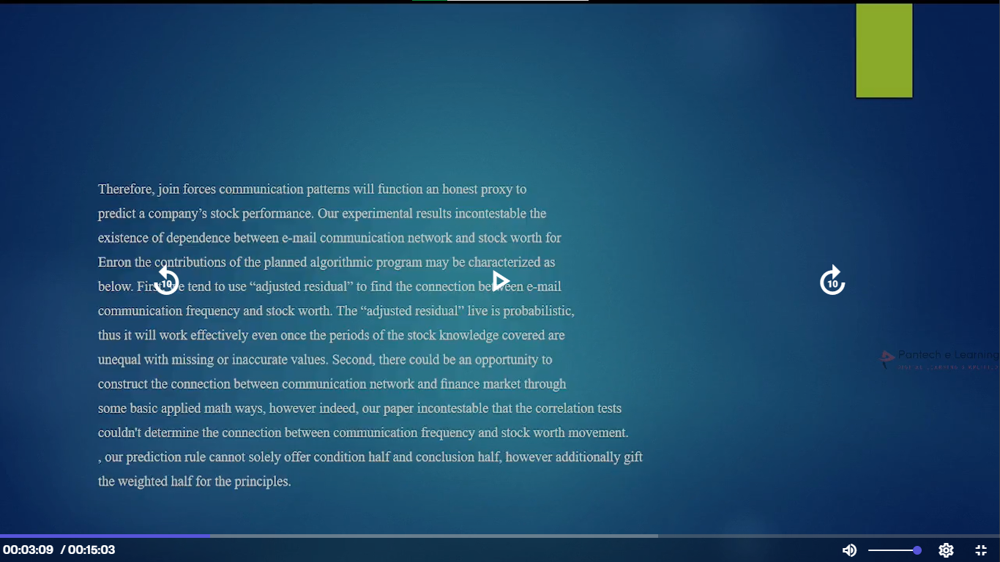

In [4]:
from sklearn.svm import SVC
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.metrics import accuracy_score
from sklearn.metrics  import make_scorer
import pandas  as pd 
import numpy as np
import seaborn
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
import time
import warnings
warnings.filterwarnings("ignore")

In [7]:
import os
os.listdir()

['day21.ipynb', 'Softwares Used.docx', 'yahoo_data.xlsx']

In [10]:
d = pd.read_excel('yahoo_data.xlsx',sheet_name='Sheet1')

In [12]:
wsp = pd.read_csv('World-Stock-Prices-Dataset.csv')

In [13]:
d.rename(columns=lambda x: x.strip(), inplace=True)

In [14]:
d.describe()

,Open,High,Low,Close*,Adj Close**,Volume
count,1258.000000,1258.000000,1258.000000,1258.000000,1258.000000,1.258000e+03
mean,29595.823045,29776.945739,29402.432226,29599.361677,29599.361677,3.450636e+08
std,4006.078299,4009.007573,4004.949066,4007.468822,4007.468822,1.069142e+08
min,19028.360000,19121.010000,18213.650000,18591.930000,18591.930000,8.615000e+07
25%,26041.267500,26163.155000,25877.872500,26027.120000,26027.120000,2.773125e+08
50%,29201.410000,29335.685000,28996.500000,29199.460000,29199.460000,3.247250e+08
75%,33604.027500,33825.445000,33346.827500,33600.342500,33600.342500,3.875100e+08
max,36722.600000,36952.650000,36636.000000,36799.650000,36799.650000,9.159900e+08


In [18]:
d.columns

Index(['Date', 'Open', 'High', 'Low', 'Close*', 'Adj Close**', 'Volume'], dtype='object')

In [16]:
wsp.rename(columns=lambda x: x.strip(), inplace=True)
wsp.describe()

,Open,High,Low,Close,Volume,Dividends,Stock Splits,Capital Gains
count,297736.000000,297736.000000,297736.000000,297736.000000,2.977360e+05,297736.000000,297736.000000,2.0
mean,72.000628,72.814511,71.165739,72.008431,2.306050e+07,0.003583,0.000911,0.0
std,136.990779,138.452160,135.432214,136.966597,8.707692e+07,0.069645,0.117811,0.0
min,0.196890,0.199922,0.192798,0.198861,0.000000e+00,0.000000,0.000000,0.0
25%,15.570000,15.778263,15.345254,15.564332,1.359475e+06,0.000000,0.000000,0.0
50%,34.154394,34.567061,33.759998,34.167135,4.589700e+06,0.000000,0.000000,0.0
75%,78.710010,79.440320,77.955184,78.727493,1.217815e+07,0.000000,0.000000,0.0
max,3445.580078,3463.070068,3370.000000,3427.610107,7.421641e+09,15.000000,50.000000,0.0


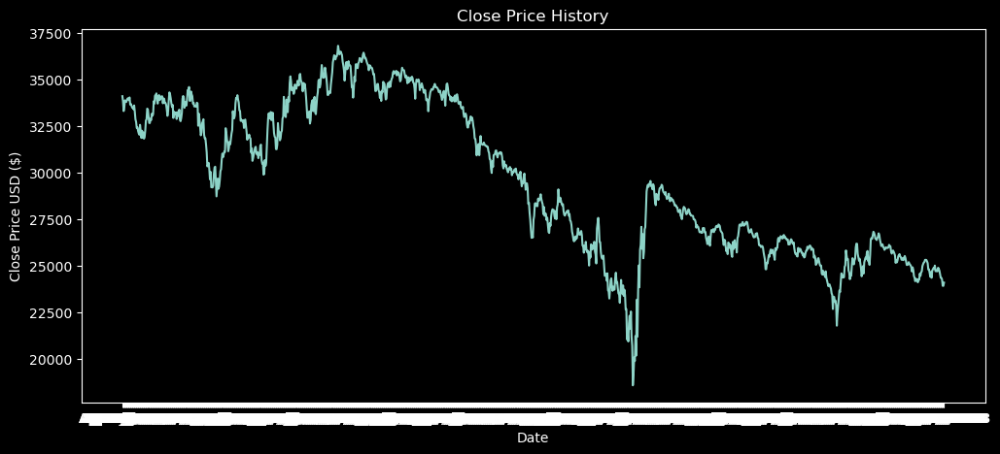

In [20]:
plt.figure(figsize=(12,5))
plt.plot(d['Date'],d['Close*'])
plt.title('Close Price History')
plt.xlabel('Date')
plt.ylabel('Close Price USD ($)')
plt.show()

In [21]:
# Draw candle stick plot
import plotly as py
import plotly.graph_objects as go
from datetime import datetime
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot


In [22]:
init_notebook_mode(connected=True)
trace = go.Candlestick(x=d['Date'], open=d['Open'], high=d['High'], low=d['Low'], close=d['Close*'])
dat = [trace]
py.offline.iplot(dat)

In [26]:
# Candle stick plot with matplotlib
# %pip install mpl_finance    
import mpl_finance
from mpl_finance import candlestick_ohlc
import matplotlib.dates as mdates

# converting date to matplotlib date format
d['Date'] = pd.to_datetime(d['Date'])
d['Date'] = d['Date'].apply(mdates.date2num)
olhc = d[['Date', 'Open', 'High', 'Low', 'Close*']]

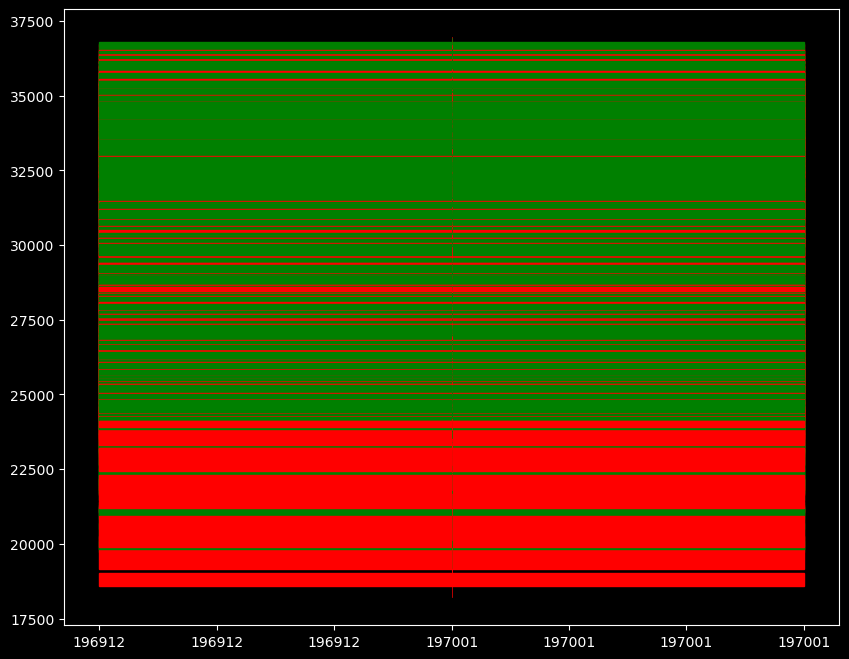

In [29]:
f, ax = plt.subplots(figsize=(10,8))
candlestick_ohlc(ax, olhc.values, width=0.6, colorup='green', colordown='red', alpha=1.0)
ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y%m'))